# Imports

In [1]:
import os, sys
sys.path.append("..")
sys.path.append("../ALAE")

import torch
import numpy as np

from src.light_sb import LightSB
from src.distributions import LoaderSampler, TensorSampler
import deeplake
from tqdm import tqdm

from torch.func import jacfwd, jacrev
import ot
import wandb
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from alae_ffhq_inference import load_model, encode, decode

In [2]:
from src import distributions
from src.distributions import Sampler, StandardNormalSampler
from src import map_benchmark

from src.icnn import DenseICNN
from src.tools import train_identity_map, unfreeze, freeze
import src.map_benchmark as mbm
from src.metrics import score_fitted_maps, score_baseline_maps, metrics_to_dict
from sklearn import datasets

In [3]:
import os, sys
import torch.nn as nn
import matplotlib
import numpy as np
import matplotlib.pyplot as plt 

import numpy as np
import torch
import gc
import copy
from sklearn.decomposition import PCA
import pandas as pd

from tqdm import tqdm
from IPython.display import clear_output

import wandb
wandb.login()

wandb: Currently logged in as: kornilov-nm (jhomanik-club). Use `wandb login --relogin` to force relogin


True

## Config

In [4]:
DIM = 512
assert DIM > 1

INPUT_DATA = "ADULT" # MAN, WOMAN, ADULT, CHILDREN
TARGET_DATA = "CHILDREN" # MAN, WOMAN, ADULT, CHILDREN

OUTPUT_SEED = 0xBADBEEF
BATCH_SIZE = 128
EPSILON = 0.1
D_LR = 1e-3 # 1e-3 for eps 0.1
D_GRADIENT_MAX_NORM = float("inf")
N_POTENTIALS = 10
SAMPLING_BATCH_SIZE = 128
INIT_BY_SAMPLES = True
IS_DIAGONAL = True

MAX_STEPS = 10000
CONTINUE = -1

In [5]:
assert torch.cuda.is_available()

In [6]:
EXP_NAME = f'LightSB_ALAE_{INPUT_DATA}_TO_{TARGET_DATA}_EPSILON_{EPSILON}'
OUTPUT_PATH = '../checkpoints/{}'.format(EXP_NAME)

config = dict(
    DIM=DIM,
    D_LR=D_LR,
    BATCH_SIZE=BATCH_SIZE,
    EPSILON=EPSILON,
    D_GRADIENT_MAX_NORM=D_GRADIENT_MAX_NORM,
    N_POTENTIALS=N_POTENTIALS,
    INIT_BY_SAMPLES=INIT_BY_SAMPLES,
    IS_DIAGONAL=IS_DIAGONAL,
)

if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Data loading

In [7]:
# To download data use

train_size = 60000
test_size = 10000

latents = np.load("../data/latents.npy")
gender = np.load("../data/gender.npy")
age = np.load("../data/age.npy")
test_inp_images = np.load("../data/test_images.npy")

train_latents, test_latents = latents[:train_size], latents[train_size:]
train_gender, test_gender = gender[:train_size], gender[train_size:]
train_age, test_age = age[:train_size], age[train_size:]

if INPUT_DATA == "MAN":
    x_inds_train = np.arange(train_size)[(train_gender == "male").reshape(-1)]
    x_inds_test = np.arange(test_size)[(test_gender == "male").reshape(-1)]
elif INPUT_DATA == "WOMAN":
    x_inds_train = np.arange(train_size)[(train_gender == "female").reshape(-1)]
    x_inds_test = np.arange(test_size)[(test_gender == "female").reshape(-1)]
elif INPUT_DATA == "ADULT":
    x_inds_train = np.arange(train_size)[
        (train_age >= 18).reshape(-1)*(train_age != -1).reshape(-1)
    ]
    x_inds_test = np.arange(test_size)[
        (test_age >= 18).reshape(-1)*(test_age != -1).reshape(-1)
    ]
elif INPUT_DATA == "CHILDREN":
    x_inds_train = np.arange(train_size)[
        (train_age < 18).reshape(-1)*(train_age != -1).reshape(-1)
    ]
    x_inds_test = np.arange(test_size)[
        (test_age < 18).reshape(-1)*(test_age != -1).reshape(-1)
    ]
x_data_train = train_latents[x_inds_train]
x_data_test = test_latents[x_inds_test]

if TARGET_DATA == "MAN":
    y_inds_train = np.arange(train_size)[(train_gender == "male").reshape(-1)]
    y_inds_test = np.arange(test_size)[(test_gender == "male").reshape(-1)]
elif TARGET_DATA == "WOMAN":
    y_inds_train = np.arange(train_size)[(train_gender == "female").reshape(-1)]
    y_inds_test = np.arange(test_size)[(test_gender == "female").reshape(-1)]
elif TARGET_DATA == "ADULT":
    y_inds_train = np.arange(train_size)[
        (train_age >= 18).reshape(-1)*(train_age != -1).reshape(-1)
    ]
    y_inds_test = np.arange(test_size)[
        (test_age >= 18).reshape(-1)*(test_age != -1).reshape(-1)
    ]
elif TARGET_DATA == "CHILDREN":
    y_inds_train = np.arange(train_size)[
        (train_age < 18).reshape(-1)*(train_age != -1).reshape(-1)
    ]
    y_inds_test = np.arange(test_size)[
        (test_age < 18).reshape(-1)*(test_age != -1).reshape(-1)
    ]
y_data_train = train_latents[y_inds_train]
y_data_test = test_latents[y_inds_test]

X_train = torch.tensor(x_data_train)
Y_train = torch.tensor(y_data_train)

X_test = torch.tensor(x_data_test)
Y_test = torch.tensor(y_data_test)

X_sampler = TensorSampler(X_train, device="cuda")
Y_sampler = TensorSampler(Y_train, device="cuda")

# Model initialisation

## Flow Matching

### TO DOWNLOAD PRE-PROCESSED ALAE DATA, UNCOMMENT THE CODE OF THE NEXT CELL.

In [30]:
def invert(D, Y, t, lr=0.1, max_iter=1000, tol=1e-3):
    freeze(D)
    Y_inv = torch.rand_like(Y, requires_grad=True)

    opt = torch.optim.Adam([Y_inv], lr=lr)
    #torch.sum(Y_inv).backward() # Terrible solution to init gradients
    opt.zero_grad()

    for it in range(max_iter):
        loss = (t[:,None]*D(Y_inv)).sum() - (Y * Y_inv).sum() + ((1-t[:,None])/2*Y_inv*Y_inv).sum()
        loss.backward()
        if torch.sqrt((Y_inv.grad.data ** 2).mean(dim=1)).mean() < tol:
            break

        opt.step()
        opt.zero_grad()
    return Y_inv.detach()

In [31]:
class ODEFunc(nn.Module):

    def __init__(self, dim = 2, hidden_layer_sizes = [128, 128, 64]):
        super(ODEFunc, self).__init__()
        self.dim = dim

        layers = [nn.Linear(dim + 1, hidden_layer_sizes[0]),
            nn.ReLU()]
        for i in range(1, len(hidden_layer_sizes)):
            layers += [nn.Linear(hidden_layer_sizes[i - 1], hidden_layer_sizes[i]),
            nn.ReLU()]
        layers += [nn.Linear(hidden_layer_sizes[-1], dim)]
        self.net = nn.Sequential(*layers)


    def push_nograd(self, X):
            
            BATCH_SIZE, n = X.shape
            def ode_func(t, x):
                x = torch.tensor(x).cuda().reshape([BATCH_SIZE, n])
                vec_t = torch.ones(BATCH_SIZE, device=x.device) * t
                with torch.no_grad():
                    drift = self.forward(x, vec_t)
                return to_flattened_numpy(drift)

            solution = integrate.solve_ivp(ode_func, (1e-6, 1), to_flattened_numpy(X), atol = 1e-4, rtol = 1e-2)
            Y = torch.tensor(solution.y[:, -1]).reshape(X.shape).cuda()
            return Y
    
    def forward(self,  X, t):
        concat = torch.cat([X, t[:,None]], 1).to(torch.float32)
        return self.net(concat)


In [24]:
class GradODEFunc(nn.Module):

    def __init__(self, dim = 2, hidden_layer_sizes = [128, 128, 64]):
        super(GradODEFunc, self).__init__()
        self.dim = dim

        layers = [nn.Linear(dim + 1, hidden_layer_sizes[0]),
            nn.ReLU()]
        for i in range(1, len(hidden_layer_sizes)):
            layers += [nn.Linear(hidden_layer_sizes[i - 1], hidden_layer_sizes[i]),
            nn.ReLU()]
        layers += [nn.Linear(hidden_layer_sizes[-1], 1)]
        self.net = nn.Sequential(*layers)


    def push_nograd(self, X):
            
            BATCH_SIZE, n = X.shape
            def ode_func(t, x):
                x = torch.tensor(x).cuda().reshape([BATCH_SIZE, n])
                vec_t = torch.ones(BATCH_SIZE, device=x.device) * t
                with torch.no_grad():
                    drift = self.forward(x, vec_t)
                return to_flattened_numpy(drift)

            solution = integrate.solve_ivp(ode_func, (1e-6, 1), to_flattened_numpy(X), atol = 1e-4, rtol = 1e-2)
            Y = torch.tensor(solution.y[:, -1]).reshape(X.shape).cuda()
            return Y
    
    def forward(self,  X, t):
        torch.set_grad_enabled(True)
        X.requires_grad = True
        t.requires_grad = True
        concat = torch.cat([X, t[:,None]], 1).to(torch.float32)
        
        output = torch.autograd.grad(
            outputs=self.net(concat), inputs=X,
            create_graph=True,
            allow_unused=True,
            only_inputs=True,
            grad_outputs=torch.ones_like(concat[:, :1], requires_grad=False)
        )[0]
        return output

In [25]:
def ind_plan(benchmark, BATCH_SIZE):
    X = benchmark.input_sampler.sample(BATCH_SIZE); 
    Y = benchmark.output_sampler.sample(BATCH_SIZE); 
    return X, Y

def disc_opt_plan(benchmark, BATCH_SIZE):
    X = benchmark.input_sampler.sample(BATCH_SIZE); 
    Y = benchmark.output_sampler.sample(BATCH_SIZE);
    a, b = torch.ones((BATCH_SIZE,)).cuda() / BATCH_SIZE, torch.ones((BATCH_SIZE,)).cuda() / BATCH_SIZE  # uniform distribution on samples
    # loss matrix
    M = ot.dist(X, Y)
    G0 = ot.emd(a, b, M)*BATCH_SIZE
    Y = G0@Y
    return X, Y

In [14]:
from scipy import integrate
def to_flattened_numpy(x):
    return x.flatten().cpu().detach().numpy()

In [15]:
def CreatePlanFromModel(model):
    def SDEPlan(benchmark, BATCH_SIZE):     
        X = benchmark.input_sampler.sample(BATCH_SIZE);
        n = X.shape[1]
        Y = model.push_nograd(X)
        return X, Y
    return SDEPlan

In [16]:
def step(model, optimizer, X, Y, t, OFM = False):
    if not OFM:
        X_t = X*(1-t[:,None]) + Y*t[:,None]            
        optimizer.zero_grad()
           
                
        lhs = model(X_t, t) - (Y - X)
                
        W_loss  = (lhs * lhs).sum(dim = 1).mean()
                
        W_loss.backward()
        optimizer.step()
        return W_loss.item()
    else:
        X_t = X*(1-t[:,None]) + Y*t[:,None] 
        Y_inv = invert(model, X_t, t)

        unfreeze(model)
        optimizer.zero_grad() 


        hes = torch.func.vmap(jacrev(jacrev(model)))(Y_inv[:,None,:]).squeeze()

        bias  = torch.eye(hes.shape[1]).repeat(X.shape[0], 1, 1).cuda()            
        mat = hes*t[:,None, None] + bias*(1-t[:, None, None])
        mat = mat.detach()


        grads  =  torch.func.vmap( jacrev(model), in_dims = 0)(Y_inv[:,None,:]).squeeze()

        #lhs = torch.linalg.solve(mat, grads)
        lhs = torch.einsum('abc,ac->ab', torch.linalg.inv(mat), grads)
        rhs = -(Y_inv - X)/t[:,None]
        W_loss  = 2*(lhs * rhs).sum(dim = 1).mean()
        W_loss.backward()
        optimizer.step(); model.convexify();
        simple_loss = (rhs * rhs).sum(dim = 1).mean()
        return simple_loss.item()


In [17]:
def RectFlowTrain(DIM, opt_class, lr, benchmark, init_plan, INNER_BATCH_SIZE = None, MAX_ITER = 200000, arc = ODEFunc, PROJECT_NAME =  "rf", NUM_ROUNDS = 1, hidden_layers = [128, 128, 64],  OUTPUT_PATH = 'exp1', BATCH_SIZE = 1024):
    
    W2_history = []
    wandb.init(
    # set the wandb project where this run will be logged
    project= PROJECT_NAME,
    name= OUTPUT_PATH,
    # track hyperparameters and run metadata
    config={
        "learning_rate": str(lr),
        "num_rounds" : str(NUM_ROUNDS),
        "max_iter" : str(MAX_ITER)
        }
    )
    L2_UVP_fwd_min, L2_UVP_inv_min = np.inf, np.inf
    
    prev_model = None
    total_iter = 0
    for round_i in tqdm(range(NUM_ROUNDS)):
        
        model = arc(dim = DIM, hidden_layer_sizes = hidden_layers).cuda()

        if (round_i == 0):
            plan = init_plan
            optimizer = opt_class(model.parameters(), lr = lr) 
            
        else:
            plan = CreatePlanFromModel(prev_model)
            optimizer = opt_class(model.parameters(), lr = lr ) 
        
        mini_iters_num = MAX_ITER // NUM_ROUNDS
        is_OFM = (arc == DenseICNN)
        
        for iteration in tqdm(range(mini_iters_num)):
            

            X, Y = plan(benchmark, BATCH_SIZE)
            t = (torch.rand(BATCH_SIZE) + 1e-8).cuda()

            if (INNER_BATCH_SIZE is not None): 
                for i in range (BATCH_SIZE//INNER_BATCH_SIZE):
                    X_mini = X[i*INNER_BATCH_SIZE : (i+1)*INNER_BATCH_SIZE]
                    Y_mini = Y[i*INNER_BATCH_SIZE : (i+1)*INNER_BATCH_SIZE]
                    t_mini = t[i*INNER_BATCH_SIZE : (i + 1) * INNER_BATCH_SIZE]
                    loss = step(model, optimizer, X_mini, Y_mini, t_mini, is_OFM)
                    wandb.log({"loss": loss})
                    W2_history.append(loss)
                    total_iter += 1
            else:
                loss = step(model, optimizer, X, Y, t, is_OFM)
                wandb.log({"loss": loss})
                W2_history.append(loss)
                total_iter += 1
            if iteration % 100 == 0:
                torch.save(model.state_dict(), f'{OUTPUT_PATH}.pt')
                       
        prev_model = copy.deepcopy(model)
        torch.save(model.state_dict(), f'{OUTPUT_PATH}_{round_i}.pt')
    wandb.finish()
    return results, W2_history, prev_model

## ALAE

In [18]:
torch.cuda.device_count()

1

In [19]:
# To download the required model run, run training_artifacts/download_all.py in the ALAE folder.

model = load_model("../ALAE/configs/ffhq.yaml", training_artifacts_dir="../ALAE/training_artifacts/ffhq/")
model = model.cuda()

In [20]:
class SillyBench:
    def __init__(self, x_sampler, y_sampler):
        self.input_sampler = x_sampler
        self.output_sampler = y_sampler       
benchmark = SillyBench(X_sampler, Y_sampler)

In [29]:
RectFlowTrain(DIM, torch.optim.Adam, 1e-3, benchmark, init_plan = disc_opt_plan, MAX_ITER = 10000, BATCH_SIZE = 128, arc = DenseICNN, PROJECT_NAME =  "alae",OUTPUT_PATH = 'alae_res/ofm_mb_llong_inv', NUM_ROUNDS = 1, hidden_layers = [512, 512, 216, 216])

--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\logging\__init__.py", line 1088, in emit
    stream.write(msg + self.terminator)
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode characters in position 124-134: character maps to <undefined>
Call stack:
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\runpy.py", line 194, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\runpy.py", line 87, in _run_code
    exec(code, run_globals)
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\site-packages\ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "C:\Users\jhoma\anaconda3\envs\gym\lib\site-packages\traitlets\config\application.py", line 992, in launch_instance
    app.start()
  File "C:\Users\j

loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
loss,15284.91602


  1%|▍                                                                            | 64/10000 [03:01<7:56:58,  2.88s/it]


  1%|▉                                                                           | 130/10000 [06:05<7:41:15,  2.80s/it]


  2%|█▍                                                                          | 196/10000 [09:16<7:40:14,  2.82s/it]


  3%|█▉                                                                          | 262/10000 [12:22<7:24:52,  2.74s/it]


  3%|██▍                                                                         | 328/10000 [15:27<7:27:58,  2.78s/it]


  4%|██▉                                                                         | 394/10000 [18:30<7:29:15,  2.81s/it]


  5%|███▍                                                                        | 460/10000 [21:34<7:28:31,  2.82s/it]


  5%|███▉                                                                        | 526/10000 [24:37<7:19:52,  2.79s/it]


  6%|████▍                                                                       | 592/10000 [27:40<7:18:26,  2.80s/it]


  7%|█████                                                                       | 658/10000 [30:43<7:18:05,  2.81s/it]


  7%|█████▌                                                                      | 724/10000 [33:46<7:09:24,  2.78s/it]


  8%|██████                                                                      | 790/10000 [36:49<6:53:19,  2.69s/it]


  9%|██████▌                                                                     | 856/10000 [39:53<7:13:46,  2.85s/it]


  9%|███████                                                                     | 922/10000 [42:56<6:51:25,  2.72s/it]


 10%|███████▌                                                                    | 988/10000 [45:57<6:55:33,  2.77s/it]


 11%|███████▉                                                                   | 1054/10000 [48:59<6:47:36,  2.73s/it]


 11%|████████▍                                                                  | 1120/10000 [52:00<6:46:32,  2.75s/it]


 12%|████████▉                                                                  | 1186/10000 [55:01<6:44:36,  2.75s/it]


 13%|█████████▍                                                                 | 1252/10000 [58:02<6:40:20,  2.75s/it]


 13%|█████████▌                                                               | 1318/10000 [1:01:03<6:27:02,  2.67s/it]


 14%|██████████                                                               | 1384/10000 [1:04:03<6:23:32,  2.67s/it]


 14%|██████████▌                                                              | 1450/10000 [1:07:05<6:22:05,  2.68s/it]


 15%|███████████                                                              | 1516/10000 [1:10:05<6:23:25,  2.71s/it]


 16%|███████████▌                                                             | 1582/10000 [1:13:06<6:27:08,  2.76s/it]


 16%|████████████                                                             | 1648/10000 [1:16:06<6:23:13,  2.75s/it]


 17%|████████████▌                                                            | 1714/10000 [1:19:07<6:20:24,  2.75s/it]


 18%|████████████▉                                                            | 1780/10000 [1:22:07<6:15:48,  2.74s/it]


 18%|█████████████▍                                                           | 1846/10000 [1:25:07<6:08:47,  2.71s/it]


 19%|█████████████▉                                                           | 1912/10000 [1:28:08<6:16:10,  2.79s/it]


 20%|██████████████▍                                                          | 1978/10000 [1:31:07<6:03:16,  2.72s/it]


 20%|██████████████▉                                                          | 2044/10000 [1:34:07<6:00:07,  2.72s/it]


 21%|███████████████▍                                                         | 2110/10000 [1:37:07<6:00:07,  2.74s/it]


 22%|███████████████▉                                                         | 2176/10000 [1:40:07<5:58:33,  2.75s/it]


 22%|████████████████▎                                                        | 2242/10000 [1:43:07<5:44:50,  2.67s/it]


 23%|████████████████▊                                                        | 2308/10000 [1:46:06<5:49:45,  2.73s/it]


 24%|█████████████████▎                                                       | 2374/10000 [1:49:06<5:43:10,  2.70s/it]


 24%|█████████████████▊                                                       | 2440/10000 [1:52:07<5:48:00,  2.76s/it]


 25%|██████████████████▎                                                      | 2506/10000 [1:55:06<5:41:34,  2.73s/it]


 26%|██████████████████▊                                                      | 2572/10000 [1:58:07<5:41:26,  2.76s/it]


 26%|███████████████████▎                                                     | 2638/10000 [2:01:06<5:35:51,  2.74s/it]


 27%|███████████████████▋                                                     | 2704/10000 [2:04:06<5:24:33,  2.67s/it]


 28%|████████████████████▏                                                    | 2770/10000 [2:07:06<5:28:17,  2.72s/it]


 28%|████████████████████▋                                                    | 2836/10000 [2:10:06<5:23:44,  2.71s/it]


 29%|█████████████████████▏                                                   | 2902/10000 [2:13:05<5:27:45,  2.77s/it]


 30%|█████████████████████▋                                                   | 2968/10000 [2:16:05<5:14:57,  2.69s/it]


 30%|██████████████████████▏                                                  | 3034/10000 [2:19:05<5:18:50,  2.75s/it]


 31%|██████████████████████▋                                                  | 3100/10000 [2:22:05<5:09:11,  2.69s/it]


 32%|███████████████████████                                                  | 3166/10000 [2:25:04<5:16:16,  2.78s/it]


 32%|███████████████████████▌                                                 | 3232/10000 [2:28:04<4:57:49,  2.64s/it]


 33%|████████████████████████                                                 | 3298/10000 [2:31:03<5:02:21,  2.71s/it]


 34%|████████████████████████▌                                                | 3364/10000 [2:34:03<4:54:24,  2.66s/it]


 34%|█████████████████████████                                                | 3430/10000 [2:37:02<4:55:55,  2.70s/it]


 35%|█████████████████████████▌                                               | 3496/10000 [2:40:02<4:52:54,  2.70s/it]


 36%|██████████████████████████                                               | 3562/10000 [2:43:01<4:56:47,  2.77s/it]


 36%|██████████████████████████▍                                              | 3628/10000 [2:46:00<4:43:27,  2.67s/it]


 37%|██████████████████████████▉                                              | 3694/10000 [2:49:01<4:45:46,  2.72s/it]


 38%|███████████████████████████▍                                             | 3760/10000 [2:52:00<4:44:28,  2.74s/it]


 38%|███████████████████████████▉                                             | 3826/10000 [2:55:00<4:34:41,  2.67s/it]


 39%|████████████████████████████▍                                            | 3892/10000 [2:58:00<4:36:47,  2.72s/it]


 40%|████████████████████████████▉                                            | 3958/10000 [3:00:59<4:31:54,  2.70s/it]


 40%|█████████████████████████████▍                                           | 4024/10000 [3:03:59<4:30:41,  2.72s/it]


 41%|█████████████████████████████▊                                           | 4090/10000 [3:06:59<4:31:39,  2.76s/it]


 42%|██████████████████████████████▎                                          | 4156/10000 [3:09:59<4:26:10,  2.73s/it]


 42%|██████████████████████████████▊                                          | 4222/10000 [3:12:59<4:23:17,  2.73s/it]


 43%|███████████████████████████████▎                                         | 4288/10000 [3:15:59<4:26:19,  2.80s/it]


 44%|███████████████████████████████▊                                         | 4354/10000 [3:18:59<4:18:38,  2.75s/it]


 44%|████████████████████████████████▎                                        | 4420/10000 [3:21:59<4:17:12,  2.77s/it]


 45%|████████████████████████████████▋                                        | 4486/10000 [3:24:58<4:09:11,  2.71s/it]


 46%|█████████████████████████████████▏                                       | 4552/10000 [3:27:58<4:08:25,  2.74s/it]


 46%|█████████████████████████████████▋                                       | 4618/10000 [3:30:59<4:10:04,  2.79s/it]


 47%|██████████████████████████████████▏                                      | 4684/10000 [3:34:00<4:03:12,  2.75s/it]


 48%|██████████████████████████████████▋                                      | 4750/10000 [3:37:01<3:58:11,  2.72s/it]


 48%|███████████████████████████████████▏                                     | 4816/10000 [3:40:01<3:55:29,  2.73s/it]


 49%|███████████████████████████████████▋                                     | 4882/10000 [3:43:03<3:51:00,  2.71s/it]


 49%|████████████████████████████████████                                     | 4948/10000 [3:46:03<3:52:57,  2.77s/it]


 50%|████████████████████████████████████▌                                    | 5014/10000 [3:49:03<3:44:32,  2.70s/it]


 51%|█████████████████████████████████████                                    | 5080/10000 [3:52:02<3:45:33,  2.75s/it]


 51%|█████████████████████████████████████▌                                   | 5146/10000 [3:55:02<3:42:45,  2.75s/it]


 52%|██████████████████████████████████████                                   | 5212/10000 [3:58:02<3:41:33,  2.78s/it]


 53%|██████████████████████████████████████▌                                  | 5278/10000 [4:01:02<3:32:22,  2.70s/it]


 53%|███████████████████████████████████████                                  | 5344/10000 [4:04:01<3:25:08,  2.64s/it]


 54%|███████████████████████████████████████▍                                 | 5410/10000 [4:07:01<3:30:37,  2.75s/it]


 55%|███████████████████████████████████████▉                                 | 5476/10000 [4:10:00<3:25:45,  2.73s/it]


 55%|████████████████████████████████████████▍                                | 5542/10000 [4:13:00<3:22:09,  2.72s/it]


 56%|████████████████████████████████████████▉                                | 5608/10000 [4:16:00<3:20:09,  2.73s/it]


 57%|█████████████████████████████████████████▍                               | 5674/10000 [4:19:00<3:20:27,  2.78s/it]


 57%|█████████████████████████████████████████▉                               | 5740/10000 [4:22:02<3:46:31,  3.19s/it]


 58%|██████████████████████████████████████████▍                              | 5806/10000 [4:25:02<3:07:19,  2.68s/it]


 59%|██████████████████████████████████████████▊                              | 5872/10000 [4:28:03<3:07:52,  2.73s/it]


 59%|███████████████████████████████████████████▎                             | 5938/10000 [4:31:03<3:03:06,  2.70s/it]


 60%|███████████████████████████████████████████▊                             | 6004/10000 [4:34:04<3:00:20,  2.71s/it]


 61%|████████████████████████████████████████████▎                            | 6070/10000 [4:37:05<3:01:04,  2.76s/it]


 61%|████████████████████████████████████████████▊                            | 6136/10000 [4:40:04<2:56:21,  2.74s/it]


 62%|█████████████████████████████████████████████▎                           | 6202/10000 [4:43:05<2:53:39,  2.74s/it]


 63%|█████████████████████████████████████████████▊                           | 6268/10000 [4:46:03<2:45:56,  2.67s/it]


 63%|██████████████████████████████████████████████▏                          | 6334/10000 [4:49:02<2:51:34,  2.81s/it]


 64%|██████████████████████████████████████████████▋                          | 6400/10000 [4:52:08<2:47:55,  2.80s/it]


 65%|███████████████████████████████████████████████▏                         | 6466/10000 [4:54:51<2:39:28,  2.71s/it]


 65%|███████████████████████████████████████████████▋                         | 6532/10000 [4:57:34<2:36:24,  2.71s/it]


 66%|████████████████████████████████████████████████▏                        | 6598/10000 [5:00:01<2:09:13,  2.28s/it]


 67%|████████████████████████████████████████████████▋                        | 6664/10000 [5:02:23<2:26:23,  2.63s/it]


 67%|█████████████████████████████████████████████████▏                       | 6730/10000 [5:05:07<2:24:22,  2.65s/it]


 68%|█████████████████████████████████████████████████▌                       | 6796/10000 [5:07:37<1:18:40,  1.47s/it]


 69%|██████████████████████████████████████████████████                       | 6862/10000 [5:10:22<2:15:03,  2.58s/it]


 69%|██████████████████████████████████████████████████▌                      | 6928/10000 [5:12:48<1:29:46,  1.75s/it]


 70%|███████████████████████████████████████████████████                      | 6994/10000 [5:14:59<1:40:29,  2.01s/it]


 71%|███████████████████████████████████████████████████▌                     | 7060/10000 [5:17:05<1:16:46,  1.57s/it]


 71%|████████████████████████████████████████████████████                     | 7126/10000 [5:19:17<1:11:46,  1.50s/it]


 72%|████████████████████████████████████████████████████▌                    | 7192/10000 [5:21:34<1:24:58,  1.82s/it]


 73%|████████████████████████████████████████████████████▉                    | 7258/10000 [5:23:28<1:12:33,  1.59s/it]


 73%|██████████████████████████████████████████████████████▉                    | 7324/10000 [5:25:18<38:56,  1.15it/s]


 74%|█████████████████████████████████████████████████████▉                   | 7390/10000 [5:27:28<1:00:56,  1.40s/it]


 75%|███████████████████████████████████████████████████████▉                   | 7456/10000 [5:29:01<46:57,  1.11s/it]


 75%|██████████████████████████████████████████████████████▉                  | 7522/10000 [5:30:51<1:02:06,  1.50s/it]


 76%|███████████████████████████████████████████████████████▍                 | 7588/10000 [5:32:38<1:23:45,  2.08s/it]


 77%|█████████████████████████████████████████████████████████▍                 | 7654/10000 [5:34:08<36:58,  1.06it/s]


 77%|████████████████████████████████████████████████████████▎                | 7720/10000 [5:36:01<1:14:45,  1.97s/it]


 78%|██████████████████████████████████████████████████████████▍                | 7786/10000 [5:37:31<55:42,  1.51s/it]


 79%|█████████████████████████████████████████████████████████▎               | 7852/10000 [5:39:15<1:05:12,  1.82s/it]


 79%|█████████████████████████████████████████████████████████▊               | 7918/10000 [5:41:00<1:12:09,  2.08s/it]


 80%|███████████████████████████████████████████████████████████▉               | 7984/10000 [5:42:21<27:51,  1.21it/s]


 80%|████████████████████████████████████████████████████████████▍              | 8050/10000 [5:43:44<56:27,  1.74s/it]


 81%|████████████████████████████████████████████████████████████▊              | 8116/10000 [5:45:20<24:17,  1.29it/s]


 82%|█████████████████████████████████████████████████████████████▎             | 8182/10000 [5:47:02<28:13,  1.07it/s]


 82%|█████████████████████████████████████████████████████████████▊             | 8248/10000 [5:48:21<38:56,  1.33s/it]


 83%|██████████████████████████████████████████████████████████████▎            | 8314/10000 [5:49:56<23:53,  1.18it/s]


 84%|██████████████████████████████████████████████████████████████▊            | 8380/10000 [5:51:21<21:34,  1.25it/s]


 84%|███████████████████████████████████████████████████████████████▎           | 8446/10000 [5:52:47<40:11,  1.55s/it]


 85%|███████████████████████████████████████████████████████████████▊           | 8512/10000 [5:53:54<35:55,  1.45s/it]


 86%|████████████████████████████████████████████████████████████████▎          | 8578/10000 [5:55:11<48:02,  2.03s/it]


 86%|████████████████████████████████████████████████████████████████▊          | 8644/10000 [5:56:32<19:03,  1.19it/s]


 87%|█████████████████████████████████████████████████████████████████▎         | 8710/10000 [5:58:30<45:57,  2.14s/it]


 88%|█████████████████████████████████████████████████████████████████▊         | 8776/10000 [6:00:00<33:07,  1.62s/it]


 88%|██████████████████████████████████████████████████████████████████▎        | 8842/10000 [6:01:30<23:27,  1.22s/it]


 89%|██████████████████████████████████████████████████████████████████▊        | 8908/10000 [6:02:53<18:16,  1.00s/it]


 90%|███████████████████████████████████████████████████████████████████▎       | 8974/10000 [6:04:19<25:02,  1.46s/it]


 90%|███████████████████████████████████████████████████████████████████▊       | 9040/10000 [6:05:36<27:20,  1.71s/it]


 91%|████████████████████████████████████████████████████████████████████▎      | 9106/10000 [6:06:55<22:10,  1.49s/it]


 92%|████████████████████████████████████████████████████████████████████▊      | 9172/10000 [6:08:28<22:15,  1.61s/it]


 92%|█████████████████████████████████████████████████████████████████████▎     | 9238/10000 [6:09:36<10:56,  1.16it/s]


 93%|█████████████████████████████████████████████████████████████████████▊     | 9304/10000 [6:10:57<09:22,  1.24it/s]


 94%|██████████████████████████████████████████████████████████████████████▎    | 9370/10000 [6:12:34<18:26,  1.76s/it]


 94%|██████████████████████████████████████████████████████████████████████▊    | 9436/10000 [6:14:08<14:00,  1.49s/it]


 95%|███████████████████████████████████████████████████████████████████████▎   | 9502/10000 [6:15:50<08:50,  1.07s/it]


 96%|███████████████████████████████████████████████████████████████████████▊   | 9568/10000 [6:17:24<08:31,  1.18s/it]


 96%|████████████████████████████████████████████████████████████████████████▎  | 9634/10000 [6:19:00<10:24,  1.71s/it]


 97%|████████████████████████████████████████████████████████████████████████▊  | 9700/10000 [6:20:47<13:20,  2.67s/it]


 98%|█████████████████████████████████████████████████████████████████████████▏ | 9766/10000 [6:22:35<03:14,  1.20it/s]


 98%|█████████████████████████████████████████████████████████████████████████▋ | 9832/10000 [6:24:23<05:13,  1.87s/it]


 99%|██████████████████████████████████████████████████████████████████████████▏| 9898/10000 [6:25:45<02:30,  1.47s/it]


100%|██████████████████████████████████████████████████████████████████████████▋| 9964/10000 [6:27:13<00:47,  1.33s/it]


100%|███████████████████████████████████████████████████████████████████████████████| 1/1 [6:28:05<00:00, 23285.22s/it]


loss,█▇▅▅▄▄▄▅▃▃█▃▃▃▃▃▄▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
loss,298.81891


NameError: name 'results' is not defined

# Results plotting

In [33]:
D = GradODEFunc(DIM, [512,512,216,216]).cuda()
D.load_state_dict(torch.load('alae_res/crf_lr1e4.pt'))

<All keys matched successfully>

In [38]:
D

GradODEFunc(
  (net): Sequential(
    (0): Linear(in_features=513, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=512, bias=True)
    (3): ReLU()
    (4): Linear(in_features=512, out_features=216, bias=True)
    (5): ReLU()
    (6): Linear(in_features=216, out_features=216, bias=True)
    (7): ReLU()
    (8): Linear(in_features=216, out_features=1, bias=True)
  )
)

In [35]:
torch.manual_seed(OUTPUT_SEED); np.random.seed(OUTPUT_SEED)

inds_to_map = np.random.choice(np.arange((x_inds_test < 300).sum()), size=10, replace=False)
number_of_samples = 1

mapped_all = []
latent_to_map = torch.tensor(test_latents[x_inds_test[inds_to_map]])
latent_to_map.requires_grad = True
inp_images = test_inp_images[x_inds_test[inds_to_map]]


for k in range(number_of_samples):
    mapped = D.push_nograd(latent_to_map.cuda())
    mapped_all.append(mapped)
    
mapped = torch.stack(mapped_all, dim=1).cuda().double()
model = model.double()
decoded_all = []
with torch.no_grad():
    for k in range(number_of_samples):
        decoded_img = decode(model.cpu(), mapped[:, k].cpu())
        decoded_img = ((decoded_img * 0.5 + 0.5) * 255).type(torch.long).clamp(0, 255).cpu().type(torch.uint8).permute(0, 2, 3, 1).numpy()
        decoded_all.append(decoded_img)
        
decoded_all = np.stack(decoded_all, axis=1)

In [36]:
fig, axes = plt.subplots(10, number_of_samples+1, figsize=(number_of_samples+1, 10), dpi=200)

for i, ind in enumerate(range(10)):
    ax = axes[i]
    ax[0].imshow(inp_images[ind])
    for k in range(number_of_samples):
        ax[k+1].imshow(decoded_all[ind, k])
        
        ax[k+1].get_xaxis().set_visible(False)
        ax[k+1].set_yticks([])
        
    ax[0].get_xaxis().set_visible(False)
    ax[0].set_yticks([])
    
fig.tight_layout(pad=0.05)

In [39]:
from PIL import Image
from numpy import asarray

In [41]:
img = Image.open('max.jpg')

In [50]:
test_inp_images.shape

(300, 1024, 1024, 3)

In [52]:
photo[None, :].shape

torch.Size([1, 1280, 812, 3])

In [55]:
photo = torch.tensor(asarray(img), dtype=torch.double).cuda()
photo = photo.transpose((3, 1, 2))
latent = encode(model, photo)

TypeError: transpose() received an invalid combination of arguments - got (tuple), but expected one of:
 * (int dim0, int dim1)
 * (name dim0, name dim1)


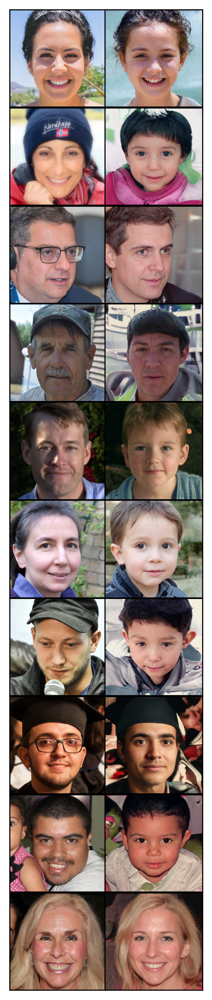

In [37]:

%matplotlib inline 

plt.show(fig)

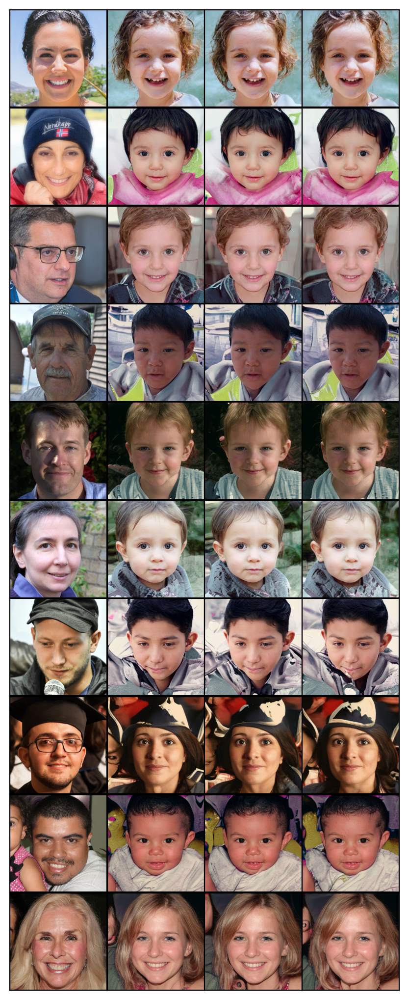

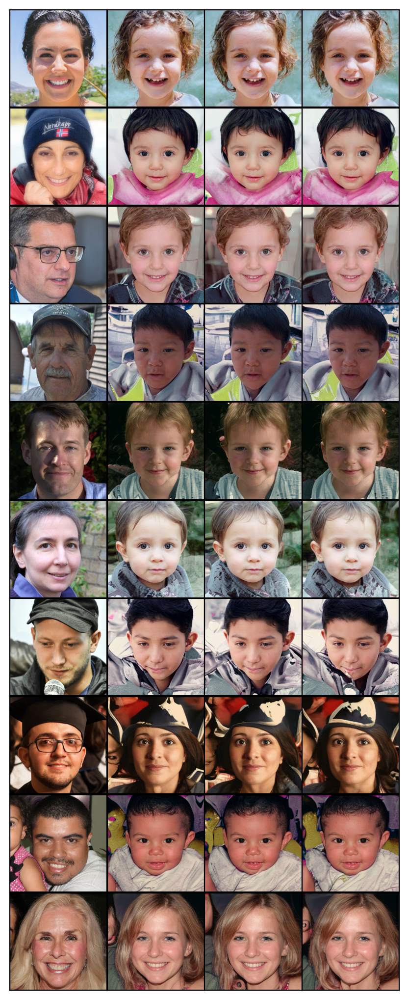

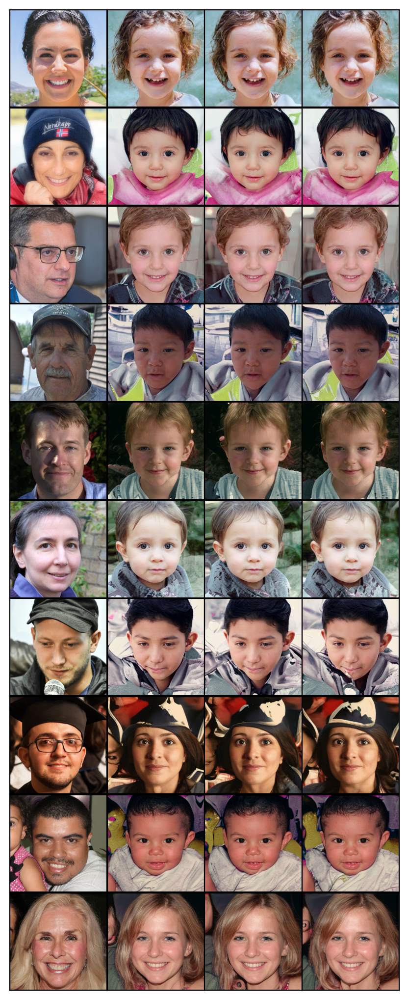

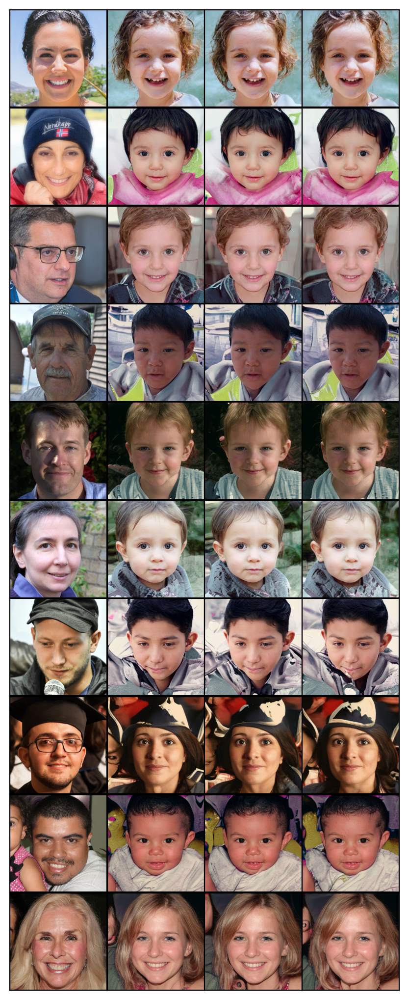

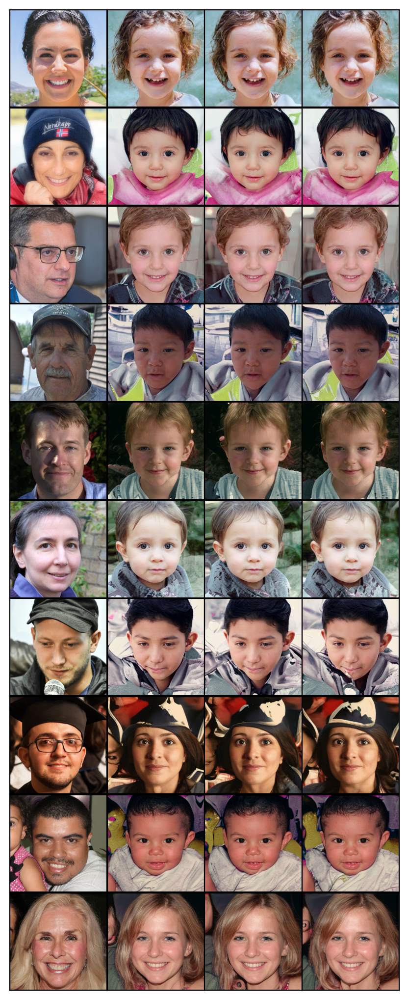

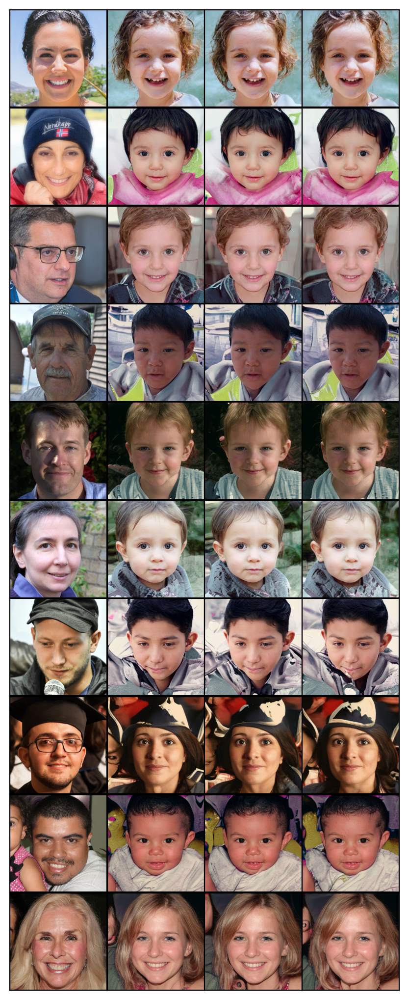

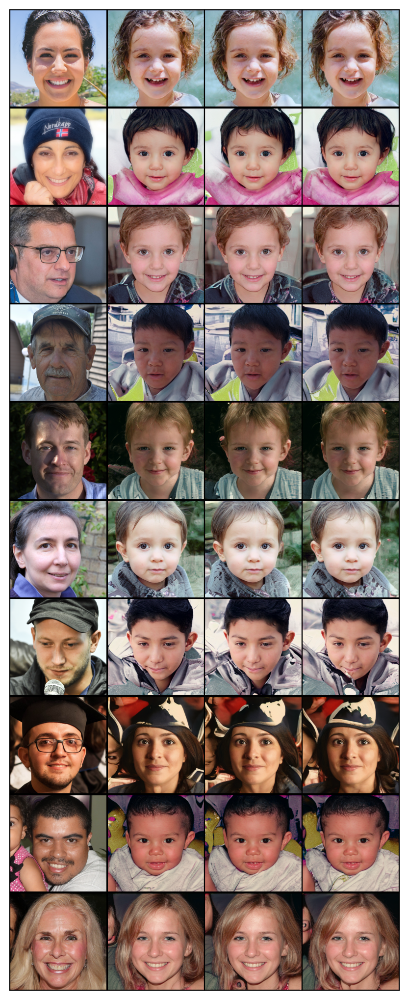

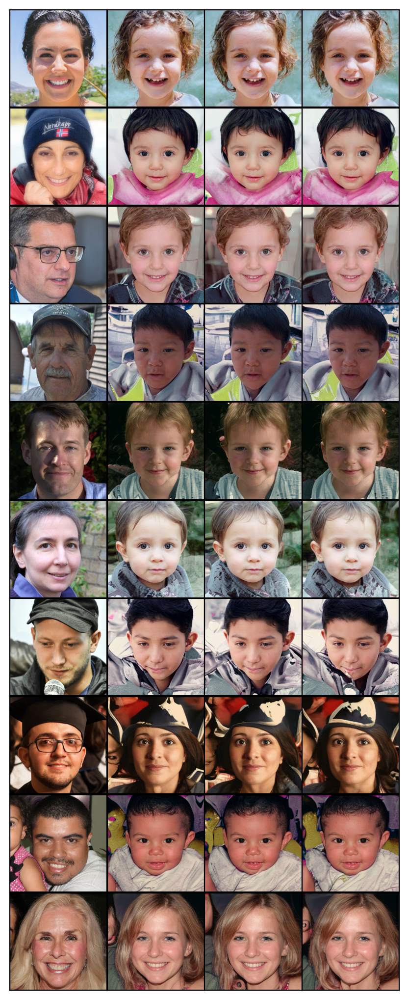

In [94]:
import matplotlib.pyplot as plt
%matplotlib inline 

plt.show(fig)